# Partie B :


Le département marketing souhaite lancer une campagne de marketing. Ils souhaitent
identifier les segments de clientèle les plus rentables pour cibler les efforts marketing et publi-
citaires de manière plus précise. Votre rôle consiste à diviser les clients de la société en groupes
distincts en fonction de certaines caractéristiques, telles que les préférences, les comportements
d’achat, ...
1. Charger à nouveau le fichier data.
2. Faites le nettoyage et les transformations nécessaires pour faire une segmentation.
3. En utilisant un algorithme de machine learning, faire une segmentation des clients et
justifier le nombres de classes obtenues.
4. Décriver pour chaque classe en precisant sa proportion sur le chiffre d’affaires de la
societé et les produits plus achetés par les clients de chaque classe

In [42]:
import pandas as pd

##  Chargement à nouveau du fichier data.


In [43]:
data = pd.read_csv("data.csv", sep=",")
data.info()
data.isna().sum()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 186850 entries, 0 to 186849
Data columns (total 6 columns):
 #   Column            Non-Null Count   Dtype 
---  ------            --------------   ----- 
 0   Order ID          186305 non-null  object
 1   Product           186305 non-null  object
 2   Quantity Ordered  186305 non-null  object
 3   Price Each        186305 non-null  object
 4   Order Date        186305 non-null  object
 5   Purchase Address  186305 non-null  object
dtypes: object(6)
memory usage: 8.6+ MB


Order ID            545
Product             545
Quantity Ordered    545
Price Each          545
Order Date          545
Purchase Address    545
dtype: int64

In [44]:
data.dropna(inplace=True)
data.info()
data.isna().sum()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 186305 entries, 0 to 186849
Data columns (total 6 columns):
 #   Column            Non-Null Count   Dtype 
---  ------            --------------   ----- 
 0   Order ID          186305 non-null  object
 1   Product           186305 non-null  object
 2   Quantity Ordered  186305 non-null  object
 3   Price Each        186305 non-null  object
 4   Order Date        186305 non-null  object
 5   Purchase Address  186305 non-null  object
dtypes: object(6)
memory usage: 9.9+ MB


Order ID            0
Product             0
Quantity Ordered    0
Price Each          0
Order Date          0
Purchase Address    0
dtype: int64

## Nettoyage et les transformations nécessaires pour faire une segmentation.

In [45]:
# Convertir 'Quantity Ordered' en nombre entier
data['Quantity Ordered'] = pd.to_numeric(data['Quantity Ordered'], errors='coerce')

# Convertir 'Price Each' en nombre décimal
data['Price Each'] = pd.to_numeric(data['Price Each'], errors='coerce')


In [46]:
# Vérifier le type de données des colonnes 'Quantity Ordered' et 'Price Each'
print(data['Quantity Ordered'].dtype)
print(data['Price Each'].dtype)


float64
float64


In [47]:
# Supprimer les lignes où 'Order Date' est égal à 'Order Date'
data = data[data['Order Date'] != 'Order Date']

# Convertir 'Order Date' en datetime avec le format correct
data['Order Date'] = pd.to_datetime(data['Order Date'], format='%m/%d/%y %H:%M')

# Vérifier les types de données mis à jour
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 185950 entries, 0 to 186849
Data columns (total 6 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   Order ID          185950 non-null  object        
 1   Product           185950 non-null  object        
 2   Quantity Ordered  185950 non-null  float64       
 3   Price Each        185950 non-null  float64       
 4   Order Date        185950 non-null  datetime64[ns]
 5   Purchase Address  185950 non-null  object        
dtypes: datetime64[ns](1), float64(2), object(3)
memory usage: 9.9+ MB


In [48]:
# Diviser l'adresse en adresse, ville et code postal
data[['Adresse', 'Ville', 'Code Postal']] = data['Purchase Address'].str.split(', ', n=2).apply(lambda x: pd.Series([x[0], x[1], x[2]]))

# Afficher les premières lignes pour vérification
print(data[['Adresse', 'Ville', 'Code Postal']].head(5))

         Adresse          Ville Code Postal
0  944 Walnut St         Boston    MA 02215
1   185 Maple St       Portland    OR 97035
2   538 Adams St  San Francisco    CA 94016
3    738 10th St    Los Angeles    CA 90001
4    387 10th St         Austin    TX 73301


In [49]:
#Extraire le mois à partir de la colonne "Order Date" et le stocker dans une nouvelle colonne "Mois".
data["Month"] = data["Order Date"].dt.month
data

,Order ID,Product,Quantity Ordered,Price Each,Order Date,Purchase Address,Adresse,Ville,Code Postal,Month
0,141234,iPhone,1.0,700.00,2019-01-22 21:25:00,"944 Walnut St, Boston, MA 02215",944 Walnut St,Boston,MA 02215,1
1,141235,Lightning Charging Cable,1.0,14.95,2019-01-28 14:15:00,"185 Maple St, Portland, OR 97035",185 Maple St,Portland,OR 97035,1
2,141236,Wired Headphones,2.0,11.99,2019-01-17 13:33:00,"538 Adams St, San Francisco, CA 94016",538 Adams St,San Francisco,CA 94016,1
3,141237,27in FHD Monitor,1.0,149.99,2019-01-05 20:33:00,"738 10th St, Los Angeles, CA 90001",738 10th St,Los Angeles,CA 90001,1
4,141238,Wired Headphones,1.0,11.99,2019-01-25 11:59:00,"387 10th St, Austin, TX 73301",387 10th St,Austin,TX 73301,1
...,...,...,...,...,...,...,...,...,...,...
186845,319666,Lightning Charging Cable,1.0,14.95,2019-12-11 20:58:00,"14 Madison St, San Francisco, CA 94016",14 Madison St,San Francisco,CA 94016,12
186846,319667,AA Batteries (4-pack),2.0,3.84,2019-12-01 12:01:00,"549 Willow St, Los Angeles, CA 90001",549 Willow St,Los Angeles,CA 90001,12
186847,319668,Vareebadd Phone,1.0,400.00,2019-12-09 06:43:00,"273 Wilson St, Seattle, WA 98101",273 Wilson St,Seattle,WA 98101,12
186848,319669,Wired Headphones,1.0,11.99,2019-12-03 10:39:00,"778 River St, Dallas, TX 75001",778 River St,Dallas,TX 75001,12


In [50]:
# Nettoyage des données : Supprimer les lignes avec des valeurs non numériques dans les colonnes "Quantity Ordered" et "Price Each"
data = data.dropna(subset=['Quantity Ordered', 'Price Each'], how='any')

# Convertir les colonnes "Quantity Ordered" et "Price Each" en types numériques (float)
data['Quantity Ordered'] = pd.to_numeric(data['Quantity Ordered'], errors='coerce')
data['Price Each'] = pd.to_numeric(data['Price Each'], errors='coerce')

data['Ville'] = data['Ville'].astype(str)


# Supprimer les lignes avec des valeurs manquantes dans les colonnes converties
data = data.dropna(subset=['Quantity Ordered', 'Price Each'], how='any')
# Import des bibliothèques nécessaires

In [51]:
data['Chiffre d\'Affaire'] = data['Quantity Ordered'] * data['Price Each']
data

,Order ID,Product,Quantity Ordered,Price Each,Order Date,Purchase Address,Adresse,Ville,Code Postal,Month,Chiffre d'Affaire
0,141234,iPhone,1.0,700.00,2019-01-22 21:25:00,"944 Walnut St, Boston, MA 02215",944 Walnut St,Boston,MA 02215,1,700.00
1,141235,Lightning Charging Cable,1.0,14.95,2019-01-28 14:15:00,"185 Maple St, Portland, OR 97035",185 Maple St,Portland,OR 97035,1,14.95
2,141236,Wired Headphones,2.0,11.99,2019-01-17 13:33:00,"538 Adams St, San Francisco, CA 94016",538 Adams St,San Francisco,CA 94016,1,23.98
3,141237,27in FHD Monitor,1.0,149.99,2019-01-05 20:33:00,"738 10th St, Los Angeles, CA 90001",738 10th St,Los Angeles,CA 90001,1,149.99
4,141238,Wired Headphones,1.0,11.99,2019-01-25 11:59:00,"387 10th St, Austin, TX 73301",387 10th St,Austin,TX 73301,1,11.99
...,...,...,...,...,...,...,...,...,...,...,...
186845,319666,Lightning Charging Cable,1.0,14.95,2019-12-11 20:58:00,"14 Madison St, San Francisco, CA 94016",14 Madison St,San Francisco,CA 94016,12,14.95
186846,319667,AA Batteries (4-pack),2.0,3.84,2019-12-01 12:01:00,"549 Willow St, Los Angeles, CA 90001",549 Willow St,Los Angeles,CA 90001,12,7.68
186847,319668,Vareebadd Phone,1.0,400.00,2019-12-09 06:43:00,"273 Wilson St, Seattle, WA 98101",273 Wilson St,Seattle,WA 98101,12,400.00
186848,319669,Wired Headphones,1.0,11.99,2019-12-03 10:39:00,"778 River St, Dallas, TX 75001",778 River St,Dallas,TX 75001,12,11.99


In [52]:
from sklearn.preprocessing import LabelEncoder

# Créez une instance de LabelEncoder
label_encoder = LabelEncoder()

# Appliquez LabelEncoder pour encoder les noms de produits
data['Product Encodé'] = label_encoder.fit_transform(data['Product'])


# Appliquez LabelEncoder pour encoder les noms de villes
data['Ville Encodé'] = label_encoder.fit_transform(data['Ville'])



In [53]:
data['Product Encodé']

0         18
1         12
2         17
3          2
4         17
          ..
186845    12
186846     4
186847    16
186848    17
186849     7
Name: Product Encodé, Length: 185950, dtype: int64

## Segmentation des clients.

In [54]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

/tmp/ipykernel_36475/720228738.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = data.corr()


<Figure size 1000x800 with 0 Axes>

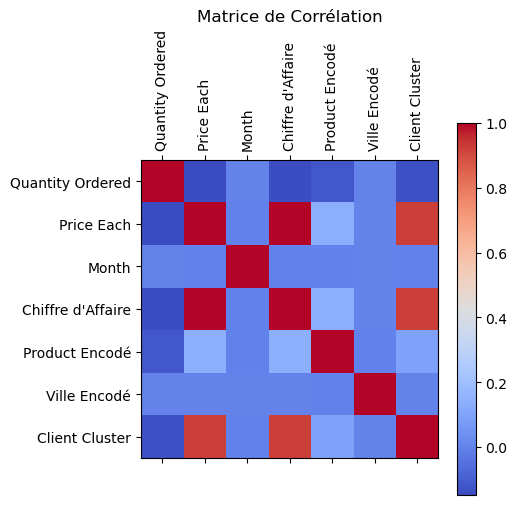

In [83]:
# Calculer la matrice de corrélation
correlation_matrix = data.corr()

# Afficher la matrice de corrélation sous forme de heatmap
plt.figure(figsize=(10, 8))
plt.matshow(correlation_matrix, cmap='coolwarm')
plt.colorbar()
plt.xticks(range(len(correlation_matrix.columns)), correlation_matrix.columns, rotation=90)
plt.yticks(range(len(correlation_matrix.columns)), correlation_matrix.columns)
plt.title('Matrice de Corrélation')
plt.show()

In [55]:
# Sélection des caractéristiques pertinentes pour la segmentation
features = data[['Month', 'Ville Encodé', 'Chiffre d\'Affaire']]

In [57]:
# Standardisation des données (important pour K-Means)
scaler = StandardScaler()
data_scaled = scaler.fit_transform(features)
data_scaled


array([[-1.72970676, -1.0497726 ,  1.54544882],
       [-1.72970676,  0.60836264, -0.51225968],
       [-1.72970676,  1.02289646, -0.48513595],
       ...,
       [ 1.41047085,  1.43743027,  0.64432839],
       [ 1.41047085, -0.63523879, -0.52115073],
       [ 1.41047085, -0.22070498, -0.25682208]])

In [58]:
# Réduction de la dimensionnalité avec PCA
pca = PCA()
data_pca = pca.fit_transform(data_scaled)
data_pca

array([[ 2.54270763, -0.10099295,  0.08220931],
       [ 0.68208713,  0.28231957, -1.75483713],
       [ 0.54632703,  0.6531679 , -1.88373512],
       ...,
       [-1.12854323,  1.55036985,  0.89080658],
       [-1.07614918, -0.82687429,  0.90704811],
       [-1.06763081, -0.33556424,  0.92285285]])

In [59]:
explained_variance_ratio = pca.explained_variance_ratio_
print(explained_variance_ratio)

[0.33468754 0.3333075  0.33200495]


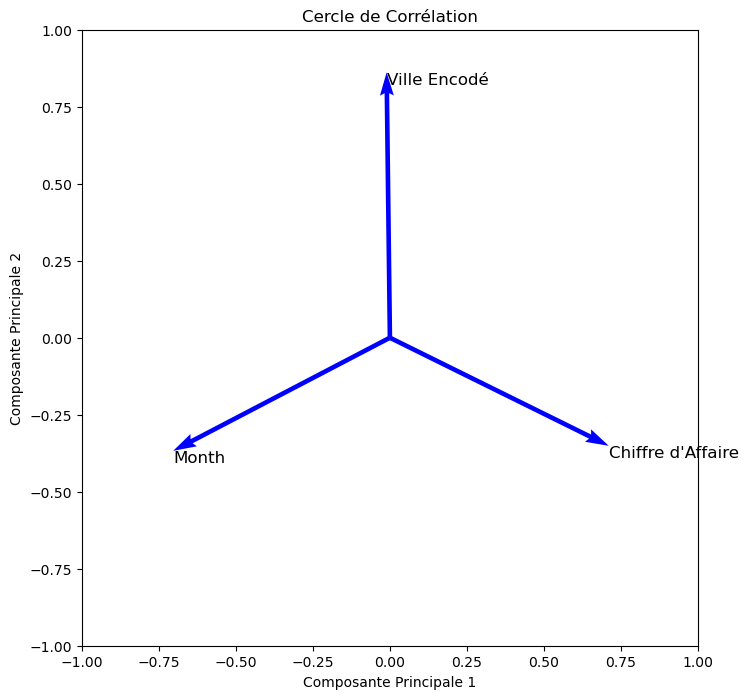

In [82]:

# Créer un cercle de corrélation
def plot_correlation_circle(pca, labels=None):
    plt.figure(figsize=(8, 8))
    num_components = pca.n_components_
    if num_components > 1:
        vectors = pca.components_
        explained_variance = pca.explained_variance_ratio_
        for i in range(num_components):
            x = vectors[i, 0]
            y = vectors[i, 1]
            plt.quiver(0, 0, x, y, angles='xy', scale_units='xy', scale=1, color='b')
            if labels is not None:
                plt.text(x, y, labels[i], fontsize=12, ha='left', va='top')
                plt.xlim(-1, 1)
                plt.ylim(-1, 1)
        # Ajouter un cercle
        # circle = plt.Circle((0, 0), 1, color='r', fill=False)
        # plt.gca().add_artist(circle)
        plt.gca().set_aspect('equal', adjustable='box')
        plt.xlabel('Composante Principale 1')
        plt.ylabel('Composante Principale 2')
        plt.title('Cercle de Corrélation')

# Afficher le cercle de corrélation
plot_correlation_circle(pca, labels=features.columns)

plt.show()

In [61]:
# Choix du nombre optimal de clusters en utilisant la méthode Elbow
wcss = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=0)
    kmeans.fit(features)
    wcss.append(kmeans.inertia_)

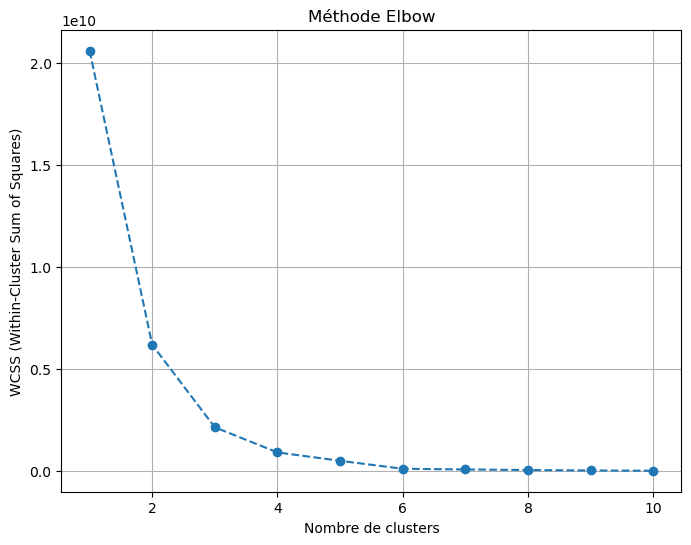

In [62]:
# Affichage de la courbe Elbow
plt.figure(figsize=(8, 6))
plt.plot(range(1, 11), wcss, marker='o', linestyle='--')
plt.title('Méthode Elbow')
plt.xlabel('Nombre de clusters')
plt.ylabel('WCSS (Within-Cluster Sum of Squares)')
plt.grid()
plt.show()

In [63]:
# À partir de la courbe Elbow, choisissez le nombre optimal de clusters
nombre_optimal_de_clusters = 3  # Modifiez ce nombre en fonction de la courbe Elbow

# Appliquez l'algorithme de clustering (K-Means) avec le nombre optimal de clusters
kmeans = KMeans(n_clusters=nombre_optimal_de_clusters, init='k-means++', max_iter=300, n_init=10, random_state=0)
data['Client Cluster' # circle = plt.Circle((0, 0), 1, color='r', fill=False)
        # plt.gca().add_artist(circle)] = kmeans.fit_predict(features)


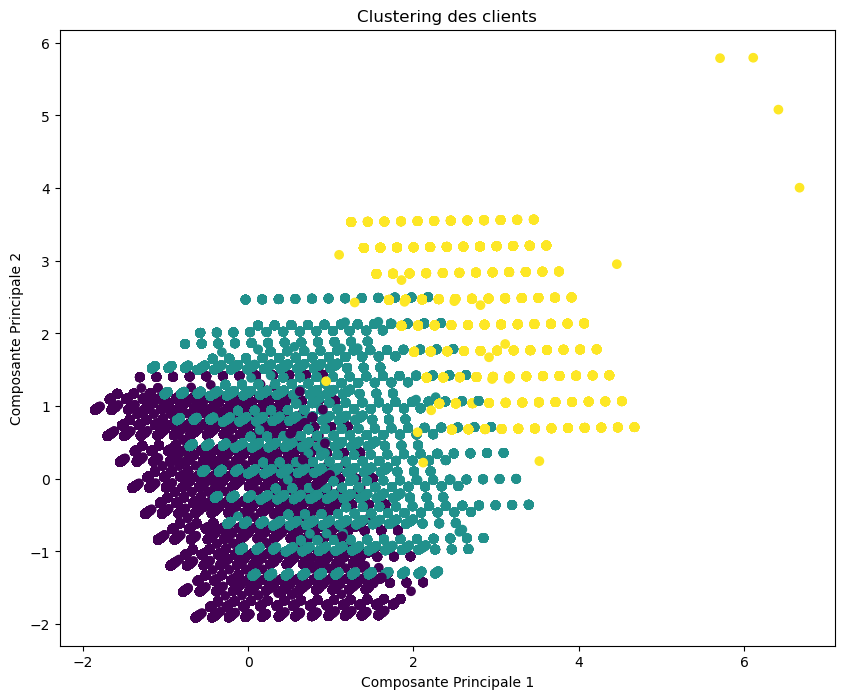

In [64]:
# Visualisation des clusters en deux dimensions
plt.figure(figsize=(10, 8))
plt.scatter(data_pca[:, 0], data_pca[:, 1], c=data['Client Cluster'], cmap='viridis')
plt.title('Clustering des clients')
plt.xlabel('Composante Principale 1')
plt.ylabel('Composante Principale 2')
plt.show()


Animation size has reached 20993575 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


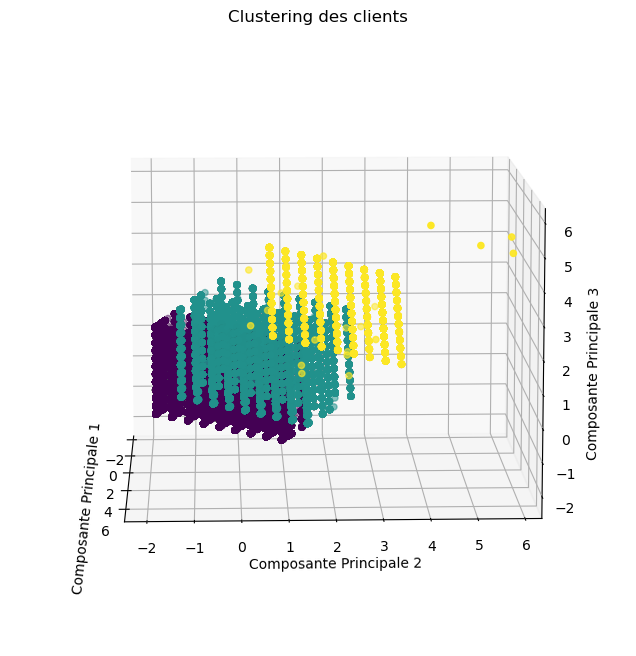

In [65]:
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Créez la figure et l'axe 3D
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Données pour les points
x = data_pca[:, 0]
y = data_pca[:, 1]
z = data_pca[:, 2]

# Créez la dispersion initiale
sc = ax.scatter(x, y, z, c=data['Client Cluster'], cmap='viridis')

# Fonction de mise à jour de l'animation
def update(num, x, y, z, sc):
    ax.cla()
    ax.scatter(x, y, z, c=data['Client Cluster'], cmap='viridis')
    ax.set_title('Clustering des clients')
    ax.set_xlabel('Composante Principale 1')
    ax.set_ylabel('Composante Principale 2')
    ax.set_zlabel('Composante Principale 3')
    ax.view_init(elev=10, azim=num)  # Ajustez elev et azim pour modifier l'angle de vue

# Créez l'animation
ani = FuncAnimation(fig, update, frames=range(0, 360, 2), fargs=(x, y, z, sc), repeat=True)

# Affichez l'animation
HTML(ani.to_jshtml())


In [66]:
# import seaborn as sns

# # Calcul de la proportion sur le chiffre d'affaires
# for cluster in range(nombre_optimal_de_clusters):
#     segment = data[data['Client Cluster'] == cluster]
#     chiffre_affaires_total = (segment['Quantity Ordered'] * segment['Price Each']).sum()
#     chiffre_affaires_total_global = (data['Quantity Ordered'] * data['Price Each']).sum()
#     proportion_chiffre_affaires = chiffre_affaires_total / chiffre_affaires_total_global
#     print(f"Segment {cluster + 1} :")
#     print(f"Proportion sur le chiffre d'affaires total : {proportion_chiffre_affaires:.2%}")

#     print("Distribution des mois :")
#     print(segment['Month'].value_counts())
#     print("Distribution des villes :")
#     print(segment['Ville'].value_counts())

#     print("Moyenne du prix unitaire : ", segment['Price Each'].mean())
#     print("Moyenne de la quantité commandée : ", segment['Quantity Ordered'].mean())


#     monthly_revenue = segment.groupby('Month')['Chiffre d\'Affaire'].sum()
#     plt.figure(figsize=(8, 6))
#     sns.lineplot(x=monthly_revenue.index, y=monthly_revenue.values)
#     plt.title(f'Évolution du chiffre d\'affaires pour la classe {cluster + 1}')
#     plt.xlabel('Mois')
#     plt.ylabel('Chiffre d\'affaires')
#     plt.show()




Segment 1 :
Proportion sur le chiffre d'affaires total : 22.60%
Produits les plus achetés pour le Segment 1 :
USB-C Charging Cable, Lightning Charging Cable, AAA Batteries (4-pack), AA Batteries (4-pack), Wired Headphones
Distribution des mois :


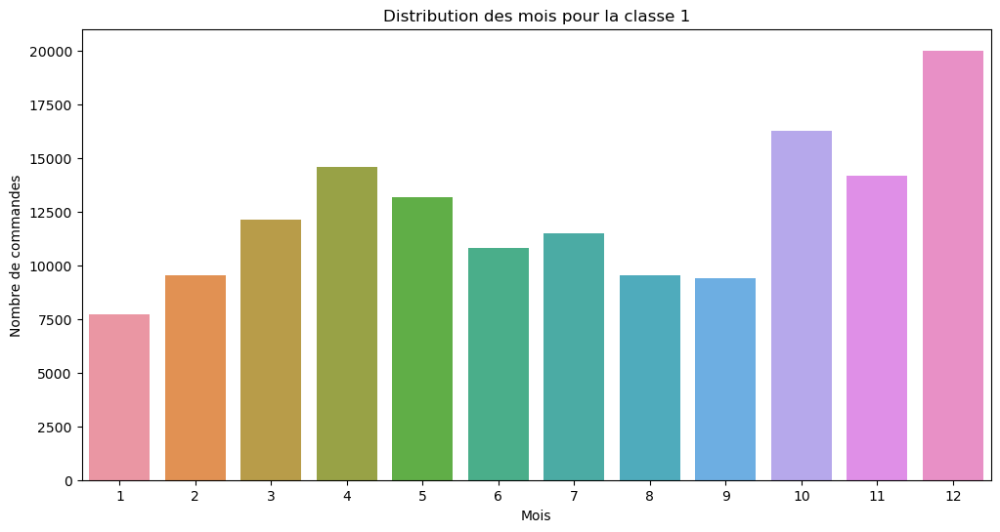

Distribution des villes :


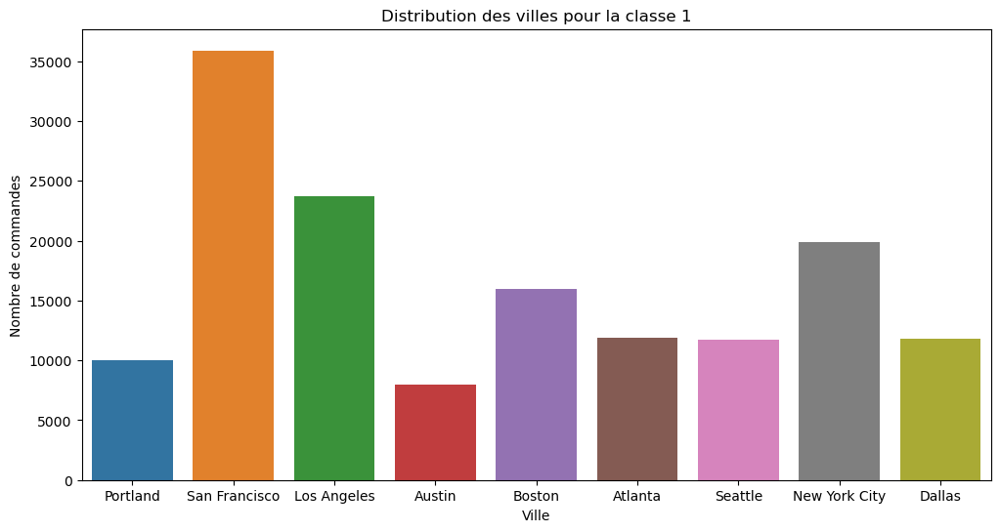

Moyenne du prix unitaire :  51.22490192918488
Moyenne de la quantité commandée :  1.1547981171477877


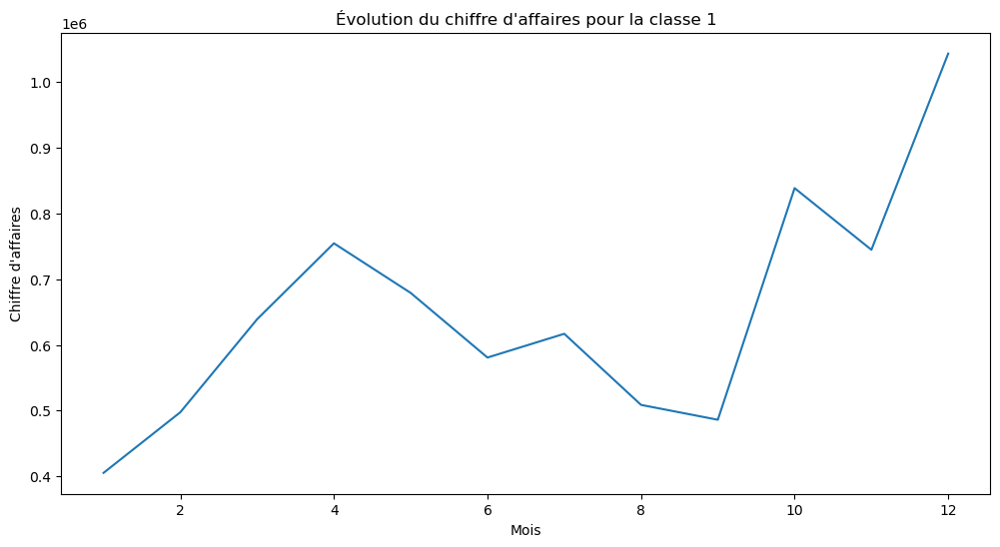

Segment 2 :
Proportion sur le chiffre d'affaires total : 54.04%
Produits les plus achetés pour le Segment 2 :
iPhone, 27in 4K Gaming Monitor, 34in Ultrawide Monitor, Google Phone, ThinkPad Laptop
Distribution des mois :


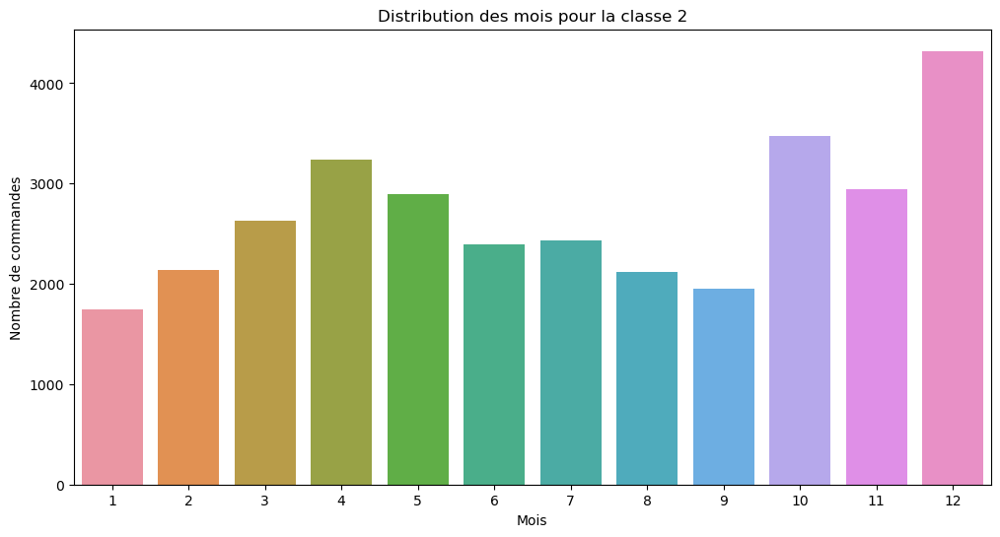

Distribution des villes :


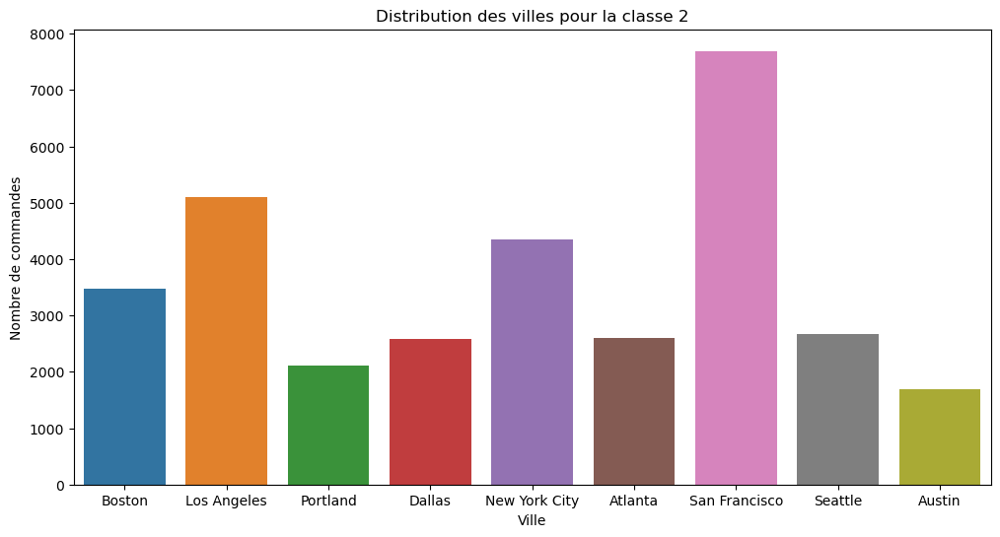

Moyenne du prix unitaire :  576.6613383095362
Moyenne de la quantité commandée :  1.0017344442035494


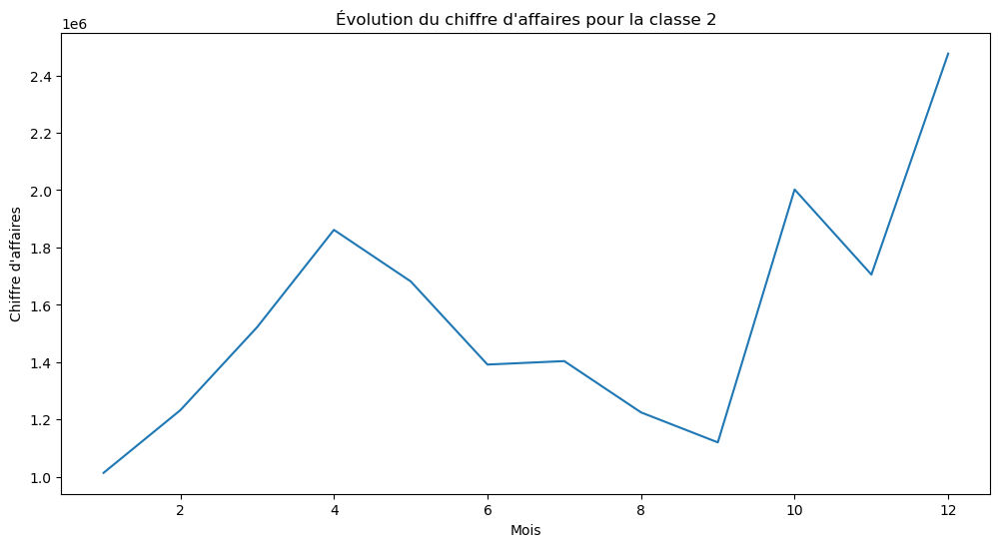

Segment 3 :
Proportion sur le chiffre d'affaires total : 23.37%
Produits les plus achetés pour le Segment 3 :
Macbook Pro Laptop, Google Phone, iPhone, ThinkPad Laptop
Distribution des mois :


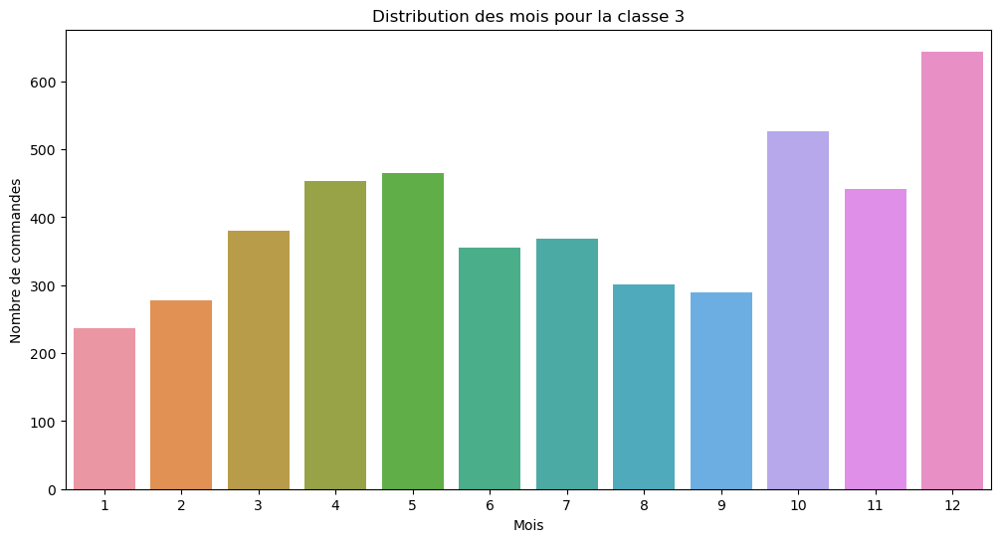

Distribution des villes :


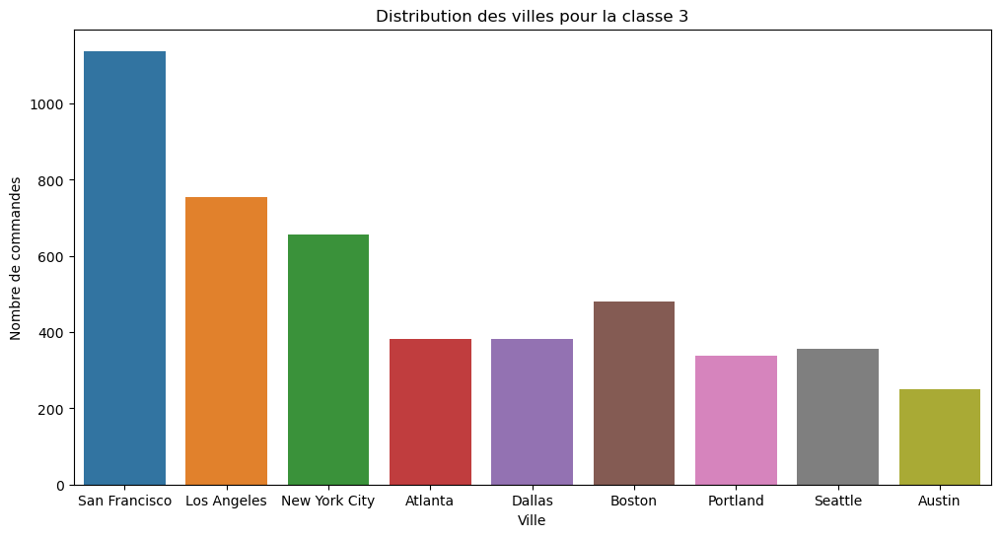

Moyenne du prix unitaire :  1696.603371308017
Moyenne de la quantité commandée :  1.0042194092827004


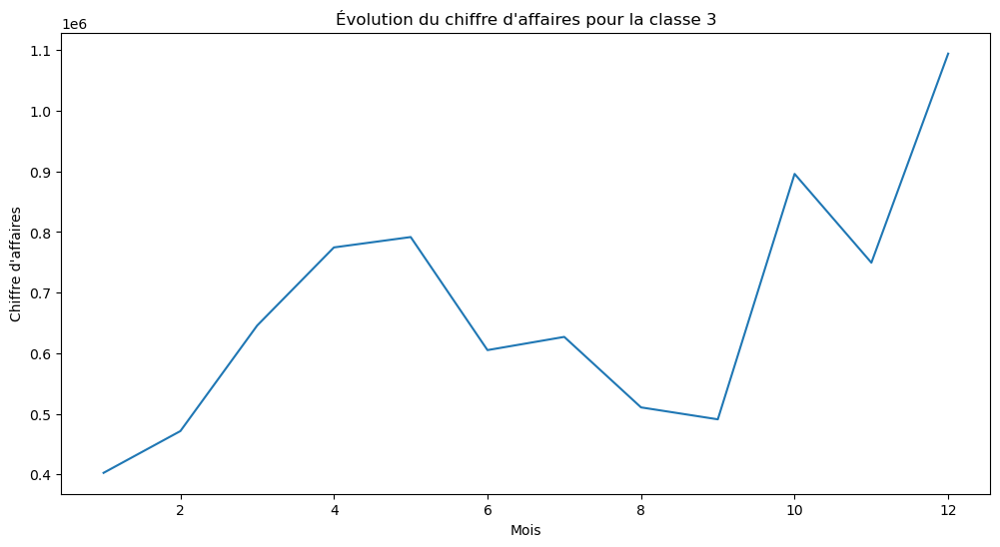

In [67]:
import seaborn as sns
import matplotlib.pyplot as plt

# Calcul de la proportion sur le chiffre d'affaires
for cluster in range(nombre_optimal_de_clusters):
    segment = data[data['Client Cluster'] == cluster]
    
    chiffre_affaires_total = (segment['Quantity Ordered'] * segment['Price Each']).sum()
    chiffre_affaires_total_global = (data['Quantity Ordered'] * data['Price Each']).sum()
    proportion_chiffre_affaires = chiffre_affaires_total / chiffre_affaires_total_global
    
    print(f"Segment {cluster + 1} :")
    print(f"Proportion sur le chiffre d'affaires total : {proportion_chiffre_affaires:.2%}")

    top_products = segment['Product'].value_counts().index[:5]  # Les 5 produits les plus achetés
    print(f"Produits les plus achetés pour le Segment {cluster + 1} :")
    print(', '.join(top_products))
    
    print("Distribution des mois :")
    plt.figure(figsize=(12, 6))
    sns.countplot(data=segment, x='Month', order=range(1, 13))
    plt.title(f"Distribution des mois pour la classe {cluster + 1}")
    plt.xlabel('Mois')
    plt.ylabel('Nombre de commandes')
    plt.show()
    
    print("Distribution des villes :")
    plt.figure(figsize=(12, 6))
    sns.countplot(data=segment, x='Ville')
    plt.title(f"Distribution des villes pour la classe {cluster + 1}")
    plt.xlabel('Ville')
    plt.ylabel('Nombre de commandes')
    plt.show()

    print("Moyenne du prix unitaire : ", segment['Price Each'].mean())
    print("Moyenne de la quantité commandée : ", segment['Quantity Ordered'].mean())

    monthly_revenue = segment.groupby('Month')['Chiffre d\'Affaire'].sum()
    plt.figure(figsize=(12, 6))
    sns.lineplot(x=monthly_revenue.index, y=monthly_revenue.values)
    plt.title(f'Évolution du chiffre d\'affaires pour la classe {cluster + 1}')
    plt.xlabel('Mois')
    plt.ylabel('Chiffre d\'affaires')
    plt.show()


Les segments de clients, tels qu'identifiés dans l'analyse de clustering, nous donnent une vision plus claire et détaillée des différents profils de clients qui achètent les produits. Voici ce que nous comprenons des segments de clients :

**Segment 1 :**
- Proportion sur le chiffre d'affaires total : 22.60%
- Mois d'activité : Ces clients sont plus actifs à certaines périodes de l'année, avec une forte concentration des achats en décembre et des pics en octobre et avril.
- Préférences de produits : Les produits les plus achetés par ce segment sont l'USB-C Charging Cable, le Lightning Charging Cable, les AAA Batteries (4-pack), les AA Batteries (4-pack), et les Wired Headphones.
- Caractéristiques d'achat : Ces clients préfèrent des produits à prix unitaire plus bas (environ 51.22 $ en moyenne) et ont tendance à acheter en moyenne 1.15 unités d'un produit à la fois.
- Localisation : La ville principale pour ces clients est San Francisco, suivie de Los Angeles et New York City.

**Segment 2 :**
- Proportion sur le chiffre d'affaires total : 54.04%
- Mois d'activité : Les clients de ce segment sont également plus actifs en décembre, avec des volumes élevés en octobre et avril.
- Préférences de produits : Les produits les plus achetés par ce segment sont l'iPhone, le 27in 4K Gaming Monitor, le 34in Ultrawide Monitor, le Google Phone, et le ThinkPad Laptop.
- Caractéristiques d'achat : Ces clients préfèrent des produits à prix unitaire plus élevé (environ 576.66 $ en moyenne) et ont tendance à commander en moyenne 1.00 unité d'un produit.
- Localisation : San Francisco est la ville principale pour ces clients, suivie de Los Angeles et New York City.

**Segment 3 :**
- Proportion sur le chiffre d'affaires total : 23.37%
- Mois d'activité : Ces clients ont également des pics d'activité en décembre, octobre et mai.
- Préférences de produits : Les produits les plus achetés par ce segment sont le Macbook Pro Laptop, le Google Phone, l'iPhone, et le ThinkPad Laptop.
- Caractéristiques d'achat : Ces clients préfèrent des produits à prix unitaire très élevé (environ 1 696.60 $ en moyenne) et ont tendance à commander en moyenne 1.00 unité d'un produit.
- Localisation : San Francisco est la ville principale pour ces clients, suivie de Los Angeles et New York City.

En combinant ces informations, voici ce que nous comprenons des segments de clients :

- Le **Segment 1** est constitué de clients qui préfèrent des produits essentiels de tous les jours à prix abordables, avec des pics d'activité en fin d'année. La personnalisation des offres pour ces clients pourrait impliquer des remises saisonnières.

- Le **Segment 2** représente la majeure partie du chiffre d'affaires et est composé de clients qui investissent dans des produits de haute technologie. Le marketing ciblé sur des produits haut de gamme pourrait être efficace pour ce groupe.

- Le **Segment 3** est composé de clients qui dépensent davantage pour des produits de haute valeur. Les promotions sur les produits de luxe pourraient attirer ces clients.

En combinant ces informations, il est possible d'ajuster les stratégies de l'entreprise pour mieux servir chaque segment de clients. Par exemple, pour le Segment 1, l'entreprise pourrait proposer davantage de promotions ou de réductions pendant les mois d'octobre et d'avril. Pour le Segment 2, elle pourrait se concentrer sur des produits de prix plus élevé. En outre, l'entreprise pourrait personnaliser ses campagnes marketing en fonction de la localisation de ses clients, ce qui permet d'optimiser les ressources et d'augmenter la satisfaction client tout en maximisant les revenus globaux.